In [36]:
import os
import glob

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation, rc
rc('animation', html='jshtml')
import seaborn as sns
import plotly.express as px
import cv2

import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import roc_curve, auc, roc_auc_score, accuracy_score
# from classification_models.keras import Classifiers
from keras_models.models import resnet

from IPython.display import clear_output
import warnings
warnings.filterwarnings('ignore')

In [37]:
TRAIN_DIR = "../content/Train"
TEST_DIR = "../content/Test"
SEED = 12
NUM_CLASSES = 14
CLASS_LABELS = ['Abuse','Arrest','Arson','Assault',
                'Burglary','Explosion','Fighting',
                "Normal",'RoadAccidents','Robbery',
                'Shooting','Shoplifting','Stealing',
                'Vandalism']

In [38]:
data_hyperparams = {
    'img_size': (224,224),
    'batch_size': 256,
    'preprocessing_function': tf.keras.applications.densenet.preprocess_input,
}

In [39]:
train_datagen = ImageDataGenerator(
    rescale=1./255,  
    rotation_range=20,  
    width_shift_range=0.2,  
    height_shift_range=0.2,  
    shear_range=0.2,  
    zoom_range=0.2,  
    horizontal_flip=True,  
    fill_mode='nearest'  
)

test_datagen = ImageDataGenerator(
    rescale = 1./255,
    preprocessing_function=data_hyperparams['preprocessing_function']
)

In [40]:
train_generator = train_datagen.flow_from_directory(
    directory = TRAIN_DIR,
    target_size = data_hyperparams['img_size'],
    batch_size = data_hyperparams['batch_size'],
    shuffle  = True , 
    color_mode = "rgb",
    class_mode = "categorical",
    seed = SEED
)
test_generator = test_datagen.flow_from_directory(
    directory = TEST_DIR,
    target_size = data_hyperparams['img_size'],
    batch_size = data_hyperparams['batch_size'],
    shuffle  = False , 
    color_mode = "rgb",
    class_mode = "categorical",
    seed = SEED
)

Found 1266345 images belonging to 14 classes.
Found 111308 images belonging to 14 classes.


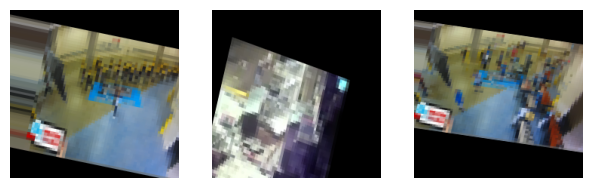

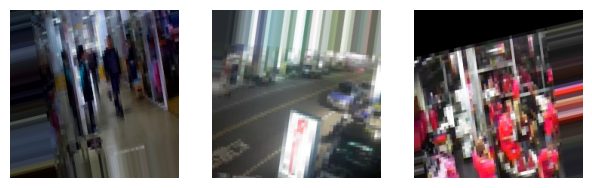

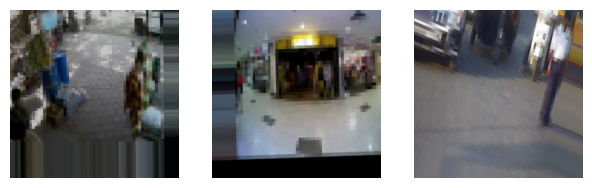

In [41]:
for i in range(3):
    img, label = train_generator[i]
    plt.figure(figsize=(10, 10))
    for j in range(3):
        plt.subplot(1, 4, j+1)
        plt.imshow(img[j])
        plt.axis('off')
    plt.show()

In [42]:
fig = px.bar(x = CLASS_LABELS,
             y = [list(train_generator.classes).count(i)
                  for i in np.unique(train_generator.classes)] , 
             color = np.unique(train_generator.classes) ,
             color_continuous_scale="Viridis") 
fig.update_xaxes(title="Classes")
fig.update_yaxes(title = "Number of Images")
fig.update_layout(showlegend = True,
    title = {
        'text': 'Train Data Distribution ',
        'y': 0.95,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [43]:
fig = px.bar(x = CLASS_LABELS,
             y = [list(test_generator.classes).count(i)
                  for i in np.unique(test_generator.classes)] , 
             color = np.unique(train_generator.classes) ,
             color_continuous_scale="Sunset") 
fig.update_xaxes(title="Classes")
fig.update_yaxes(title = "Number of Images")
fig.update_layout(showlegend = True,
    title = {
        'text': 'Test Data Distribution ',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [44]:
n_total_train = train_generator.classes.shape[0]
n_normal_train = list(train_generator.classes).count(CLASS_LABELS.index('Normal'))

fig = px.bar(x = ['Normal', 'Not Normal'],
             y = [n_normal_train, n_total_train-n_normal_train], 
             color = ['Normal', 'Not Normal'],
             color_continuous_scale="Viridis") 
fig.update_xaxes(title="Classes")
fig.update_yaxes(title = "Number of Images")
fig.update_layout(showlegend = False,
    title = {
        'text': 'Train Data Distribution ',
        'y': 0.95,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [45]:
n_total_test = test_generator.classes.shape[0]
n_normal_test = list(test_generator.classes).count(CLASS_LABELS.index('Normal'))

fig = px.bar(x = ['Normal', 'Not Normal'],
             y = [n_normal_test, n_total_test-n_normal_test], 
             color = ['Normal', 'Not Normal'],
             color_continuous_scale="Viridis") 
fig.update_xaxes(title="Classes")
fig.update_yaxes(title = "Number of Images")
fig.update_layout(showlegend = False,
    title = {
        'text': 'Test Data Distribution ',
        'y': 0.95,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [46]:
def load_png_line(path):
    t_paths = sorted(
        glob.glob(os.path.join(path,"*")), 
        key=lambda x: x,
    )
    images = []
    for i,filename in enumerate(np.array(t_paths)):
        if i%2==0:
            data = cv2.imread(filename)
            if data.max() == 0:
                continue
            images.append(data)
    return images


def create_animation(ims):
    fig=plt.figure(figsize=(6,6))
    plt.axis('off')
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))
    
    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000//10)

Animation size has reached 20976664 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


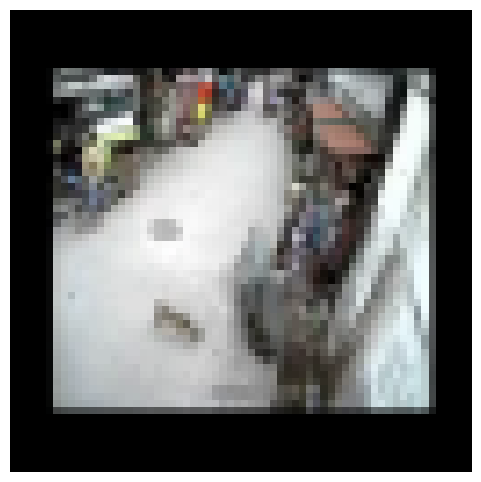

In [47]:
category = 'Explosion'  # category of crime to visualize
images = load_png_line(f"../content//Test/{category}")
create_animation(images)

In [48]:
mlp_hyperparams = {
    'pooling': 'average',
    'sizes': (64, 128, 256),
    'activations': ('relu', 'relu', 'relu'),
    'dropouts': (0.3, 0.3, 0.3),
    'num_classes': NUM_CLASSES
}

def mlp_classifier(inputs, hyperparams):
    if hyperparams['pooling'] == 'average':
        x = tf.keras.layers.GlobalAveragePooling2D()(inputs)
    else:
        x = inputs
    
    # hidden layers
    for i in range(len(hyperparams['sizes'])):
        x = tf.keras.layers.Dense(hyperparams['sizes'][i],
                                  activation=hyperparams['activations'][i])(x)
        x = tf.keras.layers.Dropout(hyperparams['dropouts'][i])(x)
    
    # output layer
    x = tf.keras.layers.Dense(hyperparams['num_classes'],
                              activation="softmax",
                              name="classification")(x)
    
    return x

In [49]:
def resnet50_extractor(inputs, hyperparams):
    feature_extractor = tf.keras.applications.resnet50.ResNet50(
        include_top=False,
        weights='imagenet',
        input_shape=hyperparams['input_shape'],
        pooling=hyperparams['pooling'],
        classes=1000
    )(inputs)
    return feature_extractor

In [50]:
resnet50_hyperparams = {
    'input_shape': (224, 224, 3),
    'weights': "imagenet",
    'classes': 1000,
    'pooling': None,  
    'trainable': False,
    'lr': 0.001
}

inputs = tf.keras.layers.Input(shape=resnet50_hyperparams['input_shape'])
feature_extractor = resnet50_extractor(inputs, resnet50_hyperparams)
classification_output = mlp_classifier(feature_extractor, mlp_hyperparams)
model = tf.keras.Model(inputs=inputs, outputs = classification_output)
model.layers[1].trainable = resnet50_hyperparams['trainable']
model.compile(optimizer=tf.keras.optimizers.SGD(resnet50_hyperparams['lr']), 
            loss='categorical_crossentropy',
            metrics = [tf.keras.metrics.AUC()])
  
clear_output()
model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 global_average_pooling2d_1  (None, 2048)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_3 (Dense)             (None, 64)                131136    
                                                                 
 dropout_3 (Dropout)         (None, 64)                0         
                                                                 
 dense_4 (Dense)             (None, 128)               8320      
                                                           

In [51]:
history = model.fit(x = train_generator,
                    validation_data=test_generator,
                    epochs = 5,)

Epoch 1/5
4947/4947 [==============================] - 50195s 10s/step - loss: 1.2770 - auc_1: 0.8795 - val_loss: 1.7980 - val_auc_1: 0.7644
Epoch 2/5
4947/4947 [==============================] - 61615s 12s/step - loss: 1.2146 - auc_1: 0.8884 - val_loss: 1.7939 - val_auc_1: 0.7695
Epoch 3/5
4947/4947 [==============================] - 51482s 10s/step - loss: 1.2015 - auc_1: 0.8922 - val_loss: 1.7917 - val_auc_1: 0.7635
Epoch 4/5
4947/4947 [==============================] - 51396s 10s/step - loss: 1.1944 - auc_1: 0.8945 - val_loss: 1.7897 - val_auc_1: 0.7604
Epoch 5/5
4947/4947 [==============================] - 50864s 10s/step - loss: 1.1889 - auc_1: 0.8964 - val_loss: 1.7873 - val_auc_1: 0.7613


435/435 [==============================] - 4134s 10s/step
ROC AUC score: 0.7679013091416931


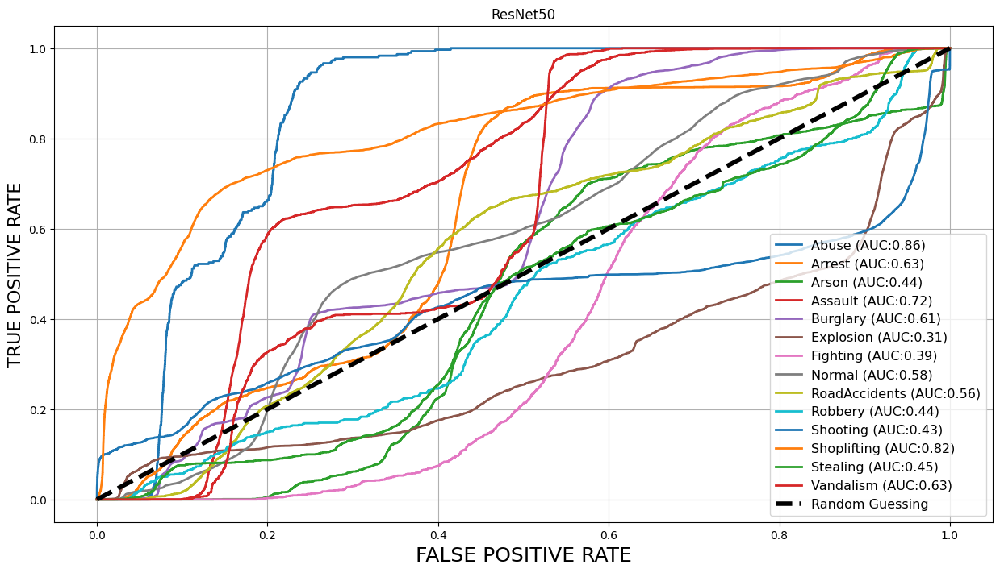

In [52]:
preds = model.predict(test_generator)
y_test = test_generator.classes
fig, c_ax = plt.subplots(1,1, figsize = (15,8))

def multiclass_roc_auc_score(y_test, y_pred, average="macro"):
    lb = LabelBinarizer()
    lb.fit(y_test)
    y_test = lb.transform(y_test)
    for (idx, c_label) in enumerate(CLASS_LABELS):
        fpr, tpr, thresholds = roc_curve(y_test[:,idx].astype(int), y_pred[:,idx])
        c_ax.plot(fpr, tpr,lw=2, label = '%s (AUC:%0.2f)'  % (c_label, auc(fpr, tpr)))
    c_ax.plot(fpr, fpr, 'black',linestyle='dashed', lw=4, label = 'Random Guessing')
    return roc_auc_score(y_test, y_pred, average=average)

print('ROC AUC score:', multiclass_roc_auc_score(y_test , preds  , average = "micro"))
plt.title("ResNet50")
plt.grid(True)
plt.xlabel('FALSE POSITIVE RATE', fontsize=18)
plt.ylabel('TRUE POSITIVE RATE', fontsize=16)
plt.legend(fontsize = 11.5)
plt.show()

In [53]:
threshold = 0.3

accuracy_results = {}
for i in range(len(CLASS_LABELS)):    
    y_pred_i = (preds.T[i] > threshold)
    y_test_i = (y_test == i)
    accuracy_results[CLASS_LABELS[i]] = accuracy_score(y_pred_i, y_test_i)

accuracy_results

{'Abuse': 0.9973317281776691,
 'Arrest': 0.9697685700937938,
 'Arson': 0.9749074639738383,
 'Assault': 0.9761292988823804,
 'Burglary': 0.9312088978330398,
 'Explosion': 0.9415136378337586,
 'Fighting': 0.9889405972616524,
 'Normal': 0.5835339777913537,
 'RoadAccidents': 0.9760753944011212,
 'Robbery': 0.9924982930247601,
 'Shooting': 0.9314514679987063,
 'Shoplifting': 0.9315143565601753,
 'Stealing': 0.9821755848636217,
 'Vandalism': 0.9900186868868365}

In [54]:
# print(y_test.shape)
for idx,c_label in enumerate(CLASS_LABELS):
    print("index : ",idx,"class : ",c_label)

index :  0 class :  Abuse
index :  1 class :  Arrest
index :  2 class :  Arson
index :  3 class :  Assault
index :  4 class :  Burglary
index :  5 class :  Explosion
index :  6 class :  Fighting
index :  7 class :  Normal
index :  8 class :  RoadAccidents
index :  9 class :  Robbery
index :  10 class :  Shooting
index :  11 class :  Shoplifting
index :  12 class :  Stealing
index :  13 class :  Vandalism


In [55]:
model.save("model1.h5")

In [56]:
load_model=tf.keras.models.load_model("model1.h5")


In [57]:
# load_model.summary()
testsample_generator = test_datagen.flow_from_directory(
    directory ="../content/Test" ,
    target_size = data_hyperparams['img_size'],
    batch_size = data_hyperparams['batch_size'],
    shuffle  = False , 
    color_mode = "rgb",
    class_mode = "categorical",
    seed = SEED
)

Found 111308 images belonging to 14 classes.


In [74]:
import tensorflow as tf
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import preprocess_input
import numpy as np
import os

# Load the pre-trained ResNet50 model
loaded_model = tf.keras.models.load_model('model1.h5')

# Load and preprocess the input image
# img_path = '../content/Test/Explosion/'
# img = image.load_img(img_path, target_size=(224, 224))  # Adjust target_size based on your model's input size
# img_array = image.img_to_array(img)
# img_array = np.expand_dims(img_array, axis=0)
# img_array = preprocess_input(img_array)

# # Make predictions
# predictions = loaded_model.predict(img_array)
# # print(predictions)
# # Interpret the predictions
# predicted_class = np.argmax(predictions)
# print("Predicted class:", predicted_class)
img_dir = '../content/Train/Shoplifting/'
predictions_dict = {}

# Iterate over all images in the directory
for img_file in os.listdir(img_dir):
    img_path = os.path.join(img_dir, img_file)

    # Load and preprocess the input image
    img = image.load_img(img_path, target_size=(224, 224))  # Adjust target_size based on your model's input size
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = preprocess_input(img_array)

    # Make predictions
    predictions = loaded_model.predict(img_array)

    # Interpret the predictions
    predicted_class = np.argmax(predictions)

    # Update the predictions dictionary
    if predicted_class not in predictions_dict:
        predictions_dict[predicted_class] = []

    predictions_dict[predicted_class].append(img_file)

# Print the predictions dictionary
print("Predictions Dictionary:")
print(predictions_dict)


1/1 [==============================] - 6s 6s/step


KeyboardInterrupt: 

In [75]:
print(predictions_dict)

{7: ['Shoplifting003_x264_0.png', 'Shoplifting003_x264_10.png', 'Shoplifting003_x264_100.png', 'Shoplifting003_x264_1000.png', 'Shoplifting003_x264_10000.png', 'Shoplifting003_x264_10010.png', 'Shoplifting003_x264_10020.png', 'Shoplifting003_x264_10030.png', 'Shoplifting003_x264_10040.png', 'Shoplifting003_x264_10050.png', 'Shoplifting003_x264_10060.png', 'Shoplifting003_x264_10070.png', 'Shoplifting003_x264_10080.png', 'Shoplifting003_x264_10090.png', 'Shoplifting003_x264_1010.png', 'Shoplifting003_x264_10100.png', 'Shoplifting003_x264_10110.png', 'Shoplifting003_x264_10120.png', 'Shoplifting003_x264_10130.png', 'Shoplifting003_x264_10140.png', 'Shoplifting003_x264_10150.png', 'Shoplifting003_x264_10160.png', 'Shoplifting003_x264_10170.png', 'Shoplifting003_x264_10180.png', 'Shoplifting003_x264_10190.png', 'Shoplifting003_x264_1020.png', 'Shoplifting003_x264_10200.png', 'Shoplifting003_x264_10210.png', 'Shoplifting003_x264_10220.png', 'Shoplifting003_x264_10230.png', 'Shoplifting003_x

In [76]:
#delete elements with key 7
predictions_dict.pop(7,None)




['Shoplifting003_x264_0.png',
 'Shoplifting003_x264_10.png',
 'Shoplifting003_x264_100.png',
 'Shoplifting003_x264_1000.png',
 'Shoplifting003_x264_10000.png',
 'Shoplifting003_x264_10010.png',
 'Shoplifting003_x264_10020.png',
 'Shoplifting003_x264_10030.png',
 'Shoplifting003_x264_10040.png',
 'Shoplifting003_x264_10050.png',
 'Shoplifting003_x264_10060.png',
 'Shoplifting003_x264_10070.png',
 'Shoplifting003_x264_10080.png',
 'Shoplifting003_x264_10090.png',
 'Shoplifting003_x264_1010.png',
 'Shoplifting003_x264_10100.png',
 'Shoplifting003_x264_10110.png',
 'Shoplifting003_x264_10120.png',
 'Shoplifting003_x264_10130.png',
 'Shoplifting003_x264_10140.png',
 'Shoplifting003_x264_10150.png',
 'Shoplifting003_x264_10160.png',
 'Shoplifting003_x264_10170.png',
 'Shoplifting003_x264_10180.png',
 'Shoplifting003_x264_10190.png',
 'Shoplifting003_x264_1020.png',
 'Shoplifting003_x264_10200.png',
 'Shoplifting003_x264_10210.png',
 'Shoplifting003_x264_10220.png',
 'Shoplifting003_x264_1023

In [77]:
print(predictions_dict)

{}
